# Notebook 5: Clustering K-means
<br>
In this notebook, we cluster the tiles (resulting from a spatial partitioning of San Francisco) using K-means.

In [1]:
import pandas as pd
import skmob
import numpy as np
import folium
import random
from folium import plugins
import matplotlib.pyplot as plt
from skmob.measures.individual import *
from skmob.measures.collective import visits_per_time_unit
from skmob.utils.gislib import getDistanceByHaversine
from skmob.utils import plot
import geopandas as gpd
from skmob.tessellation import tilers
from my_utils import *

C:\Users\giuli\Anaconda3\envs\skmob\lib\site-packages\tqdm\std.py:699: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


### Outline

1. [Data loading](#dataloading)
2. [Flows](#flows)
3. [K-means](#kmeans)
4. [Cluster analysis](#cluster_analysis)


<a id="dataloading"></a>
## 1. Data loading
Load the clean trajectory dataset and the clean ride dataset (computed in the jupyter notebook `2_data_pre_processing.ipynb`)

In [2]:
dataset_rides_path = '../data/datasets/tdf_rides_clean.zip'
dataset_traj_path = '../data/datasets/tdf_traj_clean.zip'

#load the clean trajectory dataset

df_traj = pd.read_csv(dataset_traj_path, sep='\t', parse_dates=['datetime'], compression='zip')
tdf_traj = skmob.TrajDataFrame(df_traj, latitude='lat', longitude='lng', 
                               user_id='uid', datetime='datetime')

#load the clean rides dataset
tdf_rides = pd.read_csv(dataset_rides_path, sep='\t', 
                        parse_dates=['start_time','end_time'], compression='zip')

In [3]:
# take only the rides with occupancy = 1

tdf_rides = tdf_rides[tdf_rides['occupancy']==1]

print("There are "+str(len(tdf_rides))+" rides with a passenger.")

There are 440580 rides with a passenger.


<a id="flows"></a>
## 2. Flows
Let's include also the flows in our analysis.<br>
Create dataframe in which for each taxi ride we insert two rows:
- origin info -> (start_lat, start_lng, start_time) 
- destination info -> (end_lat, end_lng, end_time) <br>

then, it will be converted in an origin-destination flow.

In [4]:
%%time


traj_ids, lats, lngs, time = [], [], [], []
flows = pd.DataFrame()

for traj_id, start_lat, start_lng, start_time, end_lat, end_lng, end_time in zip(tdf_rides.traj_id,
        tdf_rides.start_lat, tdf_rides.start_lng, tdf_rides.start_time, 
        tdf_rides.end_lat, tdf_rides.end_lng, tdf_rides.end_time):
        
        #start info
        traj_ids.append(traj_id)
        lats.append(start_lat)
        lngs.append(start_lng)
        time.append(start_time)
        
        #end info
        traj_ids.append(traj_id)
        lats.append(end_lat)
        lngs.append(end_lng)
        time.append(end_time)

flows['uid'] = traj_ids
flows['lat'] = lats
flows['lng'] = lngs
flows['datetime'] = time

Wall time: 3.3 s


In [5]:
# Load the shapfile of San Francisco
tessellation_land = gpd.GeoDataFrame.from_file("../data/shapes/sanfrancisco.geojson")
tessellation_land = tessellation_land[['geometry']]
tessellation_land = tessellation_land.explode()

tessellation_bridges = gpd.GeoDataFrame.from_file("../data/shapes/bridges.geojson")

### Create only one GeoDataFrame concatenating the SF shapefile and the bridges
tessellation_sf = tessellation_bridges.append(tessellation_land)
tessellation_sf = tessellation_sf.reset_index(drop=True)
tessellation_sf['tile_ID'] = list(np.arange(len(tessellation_sf)))
tess_style = {'color':'blue', 'fillColor':'blue'}
m_tex = plot.plot_gdf(tessellation_sf, zoom=9, style_func_args=tess_style)
m_tex

In [6]:
#get a squared tessellation of side 1000 meters using the tilers module of skmob

tessellation = tilers.tiler.get('squared', base_shape=tessellation_sf, meters=1000)
print("# tiles: "+str((len(tessellation))))
plot.plot_gdf(tessellation, zoom=9, style_func_args=tess_style)

# tiles: 17541


create a TrajDataFrame and then convert it into a FlowDataFrame that will model the origin-destination rides' flows.

In [7]:
%%time

tdf = skmob.TrajDataFrame(flows, latitude='lat', longitude='lng', 
                          datetime='datetime', user_id='uid')

fdf_flows = tdf.to_flowdataframe(tessellation)

Wall time: 53.4 s


In [8]:
fdf_flows[:3]

,origin,destination,flow
0,1105,1681,1
1,1257,1348,1
2,1331,1885,1


In [9]:
tiles_ids = list(set(list(fdf_flows['origin'].unique()) + list(fdf_flows['destination'].unique())))
print("Number of tiles in which start/end at least one ride: "+str(len(tiles_ids)))

Number of tiles in which start/end at least one ride: 1539


In [10]:
#consider only the tiles involved in at least one Taxi ride

tex_kmeans = tessellation[tessellation['tile_ID'].isin(tiles_ids)]
plot.plot_gdf(tex_kmeans, zoom=9, popup_features=['tile_ID'], style_func_args=tess_style)

Compute for each tile the in_flow, out_flow, and self_flow
for a tile $i \in T$ we define:
- in_flow: number of trips $T\setminus\{i\} \rightarrow i$
- out_flow: number of trips $i \rightarrow T\setminus\{i\}$
- self_flow: number of trips $i \rightarrow i$


In [11]:
%%time

in_flows, out_flows, self_flows = [], [], []

for tile_id in tex_kmeans['tile_ID']:
    
    #self flow 
    self_df = fdf_flows[(fdf_flows['destination'] == tile_id) & (fdf_flows['origin']==tile_id)]['flow']
    if len(self_df>0):
        self_f = self_df.iloc[0]
    else:
        self_f = 0
    
    #in flow
    in_f = fdf_flows[fdf_flows['destination']==tile_id]['flow'].sum() - self_f
    
    #out_flow
    out_f = fdf_flows[fdf_flows['origin']==tile_id]['flow'].sum() - self_f
    
    self_flows.append(self_f)
    in_flows.append(in_f)
    out_flows.append(out_f)
    
tex_kmeans['in_flow'] = in_flows
tex_kmeans['out_flow'] = out_flows
tex_kmeans['self_flow'] = self_flows

Wall time: 10.6 s


In [12]:
#let's have a look at the result

tex_kmeans[:5]

,tile_ID,geometry,in_flow,out_flow,self_flow
329,329,"POLYGON ((-122.66069 37.94258, -122.66069 37.9...",1,0,0
757,757,"POLYGON ((-122.58882 37.98507, -122.58882 37.9...",1,0,0
824,824,"POLYGON ((-122.57984 37.97091, -122.57984 37.9...",1,0,0
825,825,"POLYGON ((-122.57984 37.97799, -122.57984 37.9...",1,0,0
827,827,"POLYGON ((-122.57984 37.99215, -122.57984 37.9...",2,0,0


For each tile compute the number of GPS points (that compose the trajectories) that fall inside the tile (transits), and compute the average speed of such points.

The following is a time-consuming cell ($\approx$ 5 min).

If the file `../data/datasets/mtdf_traj_1000_kmeans.zip` containing the result of the operations performed in the time-consuming cell is available, you can use `run_time_consuming_ops = False`, and the time-consuming operations won't be executed, since the cell will simply load the result file to save time.

 If you want to run the time-consuming operations anyway, set `run_time_consuming_ops = True`.

In [13]:
%%time

run_time_consuming_cell = False

if run_time_consuming_cell:
    tdf_traj_1 = tdf_traj[tdf_traj['occupancy']==1]
    mtdf_traj_1 = tdf_traj_1.mapping(tessellation)
    
    #save and compress the dataset into a zip file (for future time saving)
    #save the dataframe with the column ['tile_ID']
    save_csv_zipped(mtdf_traj_1[['tile_ID']],'mtdf_traj_1000_kmeans','datasets')
    print("Time consuming operations performed!")
    
else:
    mtdf_traj_1_col = pd.read_csv("../data/datasets/mtdf_traj_1000_kmeans.zip", sep='\t', 
                          compression='zip')
    mtdf_traj_1 = tdf_traj[tdf_traj['occupancy']==1]
    mtdf_traj_1 = mtdf_traj_1.reset_index(drop=True)
    mtdf_traj_1['tile_ID'] = mtdf_traj_1_col['tile_ID']
    print("Time-saving file loaded!")   

Time-saving file loaded!
Wall time: 696 ms


In [14]:
#append to each tile the number of transits and avg. speed

gb_mean = mtdf_traj_1.groupby(["tile_ID"], as_index=False).mean()
gb_count = mtdf_traj_1.groupby(["tile_ID"], as_index=False).count()

speeds = []
transits = []

for tile_id in tex_kmeans['tile_ID']:

    avg_speed = gb_mean[gb_mean['tile_ID']==int(tile_id)]['speed_kmh'].iloc[0]
    num_transits = gb_count[gb_count['tile_ID']==int(tile_id)]['uid'].iloc[0]
    
    speeds.append(avg_speed)
    transits.append(num_transits)
    
tex_kmeans['transits'] = transits
tex_kmeans['speed_kmh'] = speeds

In [15]:
#let's have a look at the dataset

tex_kmeans[:5]

,tile_ID,geometry,in_flow,out_flow,self_flow,transits,speed_kmh
329,329,"POLYGON ((-122.66069 37.94258, -122.66069 37.9...",1,0,0,3,16.605002
757,757,"POLYGON ((-122.58882 37.98507, -122.58882 37.9...",1,0,0,2,18.943130
824,824,"POLYGON ((-122.57984 37.97091, -122.57984 37.9...",1,0,0,5,11.419041
825,825,"POLYGON ((-122.57984 37.97799, -122.57984 37.9...",1,0,0,6,40.499432
827,827,"POLYGON ((-122.57984 37.99215, -122.57984 37.9...",2,0,0,6,20.122055


<a id="kmeans"></a>
## 3. K-MEANS

In [16]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn import metrics

In [17]:
#ensure no NAN values
tex_kmeans_clean = tex_kmeans.dropna()

In [18]:
# select the attributes for clustering

att_kmeans = ['in_flow','out_flow','self_flow','transits','speed_kmh']
tex_kmeans_clean[att_kmeans][:3]

,in_flow,out_flow,self_flow,transits,speed_kmh
329,1,0,0,3,16.605002
757,1,0,0,2,18.943130
824,1,0,0,5,11.419041


In [19]:
# apply a scaler when dealing with distance-based algorithms

scaler = MinMaxScaler()
X = scaler.fit_transform(tex_kmeans_clean[att_kmeans])
X[:3]

array([[3.35255465e-05, 0.00000000e+00, 0.00000000e+00, 7.02743158e-06,
        1.06936929e-01],
       [3.35255465e-05, 0.00000000e+00, 0.00000000e+00, 3.51371579e-06,
        1.22723012e-01],
       [3.35255465e-05, 0.00000000e+00, 0.00000000e+00, 1.40548632e-05,
        7.19234450e-02]])

Knee Method to estimate the best K (the number of clusters)

In [20]:
sse_list = list()
max_k = 25

for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    sse = kmeans.inertia_
    sse_list.append(sse)

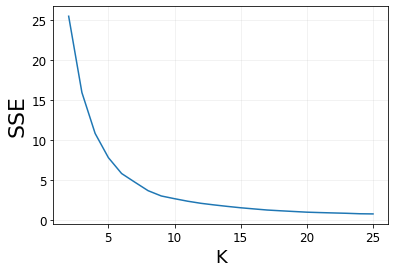

In [21]:
plt.plot(range(2, len(sse_list) + 2), sse_list)
plt.ylabel('SSE', fontsize=22)
plt.xlabel('K', fontsize=18)
plt.tick_params(axis='both', labelsize=12)
plt.grid(alpha=0.2)
plt.show()

Select k=5

In [22]:
kmeans = KMeans(n_clusters=5, n_init=10, max_iter=100, random_state=42)
kmeans.fit(X)
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 7.81055867272263
Silhouette 0.6170651207927327


In [23]:
# count the number of points in each cluster

np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3, 4]), array([266, 934, 297,   6,  28], dtype=int64))

In [24]:
### append the labels

tex_kmeans_clean['cluster_label'] = kmeans.labels_

<a id="cluster_analysis"></a>
## 4. Cluster analysis

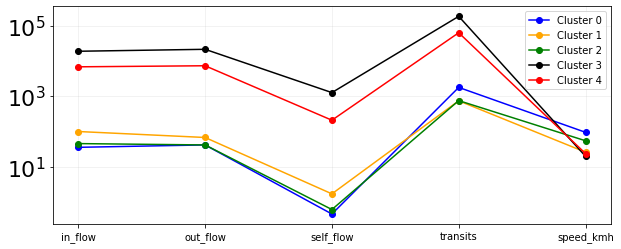

In [25]:
#Parallel coordinates with the centroid of each cluster

cluster_colors = {0:'blue',1:'orange',2:'green',3:'black',4:'red'}
centers = scaler.inverse_transform(kmeans.cluster_centers_)

plt.figure(figsize=(10, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i, c=cluster_colors[i])
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(range(0, len(tex_kmeans_clean[att_kmeans].columns)), tex_kmeans_clean[att_kmeans].columns, fontsize=10)
plt.yscale('log')
plt.grid(alpha=0.2)
plt.legend(fontsize=10, loc='best')
plt.savefig('../data/plots/centroids_kmeans.pdf')

In [26]:
for k in range(5):
    print("Cluster "+str(k)+" ("+cluster_colors[k]+")")
    for ind, at in enumerate(att_kmeans):
        print(at+": "+str(centers[k][ind]))
    print("")

Cluster 0 (blue)
in_flow: 35.313207547169675
out_flow: 41.33584905660383
self_flow: 0.4452830188679178
transits: 1796.1773584905663
speed_kmh: 94.42505066708992

Cluster 1 (orange)
in_flow: 99.58886509635985
out_flow: 67.29871520342613
self_flow: 1.6702355460385554
transits: 746.1124197002138
speed_kmh: 25.66552418632622

Cluster 2 (green)
in_flow: 45.10738255033547
out_flow: 41.258389261745066
self_flow: 0.5973154362416053
transits: 755.281879194631
speed_kmh: 54.24604166313236

Cluster 3 (black)
in_flow: 19220.833333333332
out_flow: 21849.5
self_flow: 1277.1666666666667
transits: 189818.33333333334
speed_kmh: 19.572168752957044

Cluster 4 (red)
in_flow: 6931.142857142857
out_flow: 7428.642857142856
self_flow: 208.8571428571428
transits: 64738.89285714284
speed_kmh: 23.440234965556613



In [27]:
# plot the tiles; the color represents the cluster.
tess_style = {'color':cluster_colors[0], 'fillColor':cluster_colors[0], 
                  'opacity':0, 'weight':1, 'fillOpacity':0}

m = plot.plot_gdf(tex_kmeans_clean[:1], zoom=9, popup_features=['tile_ID'])

for cluster in range(5):
    ind = cluster    
    df_cl = tex_kmeans_clean[tex_kmeans_clean['cluster_label']==cluster]
    tess_style = {'color':cluster_colors[ind], 'fillColor':cluster_colors[ind], 
                  'opacity':1, 'weight':1, 'fillOpacity':0.6}
    m = plot.plot_gdf(df_cl, zoom=5, popup_features=['tile_ID'],
                      style_func_args=tess_style, map_f=m)        
m

<table>
<thead>
  <tr>
    <th>Tile</th>
    <th>Description</th>
  </tr>
</thead>
<tbody>
  <tr>
    <td style="background-color:black"></td>
    <td style="width:500px"><b>TRAFFIC NIGHTMARE</b><br><br>Very popular for starting and/or ending a taxi ride even within the same tile.
        A large number of transits and low average speed due to traffic. Correspond with the surroundings of the downtown.<br></td>
  </tr>
  <tr>
    <td style="background-color:red"></td>
    <td style="width:500px"><b>HIGH TRAFFIC AREA</b><br><br>Popular for starting and/or ending a taxi ride but not within the same tile.
        A high number of transits and low average speed due to traffic. </td>
  </tr>
  <tr>
    <td style="background-color:orange"></td>
    <td style="width:500px"><b>MEDIUM TRAFFIC AREA</b><br><br>Tile from which more taxi rides depart than end in the tile.
A minimum number of transits and low speed indicate that the tile represents an area with medium traffic but not particularly popular.</td>
  </tr>
  <tr>
    <td style="background-color:blue"></td>
    <td style="width:500px"><b>HIGH-SPEED ROAD</b><br><br>Tile not popular for starting or ending taxi rides, but characterized by a high number of transits and a high average speed (94 km/h).
        
It coincides with the main highways, for example, the US-101 N, which connects the center and the SFO Airport, or the I-880 N which connects the center and the Oakland International Airport.</td>
  </tr>
  <tr>
    <td style="background-color:green"></td>
    <td style="width:500px"><b>URBAN ROAD</b><br><br>Tile not popular for starting or ending some taxi rides, and characterized by a number of transits with average speed typical of a road with good viability. </td>
  </tr>
</tbody>
</table>

In [28]:
#save the map
m.save("../data/plots/map_k_means.html")

#save and compress the dataset into a zip file (for future time saving)
save_csv_zipped(tex_kmeans_clean,'data_clustered_k_means','datasets')